In [42]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns

In [43]:
iono = pd.read_csv('Ionosphere.csv')

In [44]:
iono.head()

,Attribute1,Attribute2,Attribute3,Attribute4,Attribute5,Attribute6,Attribute7,Attribute8,Attribute9,Attribute10,...,Attribute26,Attribute27,Attribute28,Attribute29,Attribute30,Attribute31,Attribute32,Attribute33,Attribute34,Target
0,1,0,0.99539,-0.05889,0.85243,0.02306,0.83398,-0.37708,1.00000,0.03760,...,-0.51171,0.41078,-0.46168,0.21266,-0.34090,0.42267,-0.54487,0.18641,-0.45300,1
1,1,0,1.00000,-0.18829,0.93035,-0.36156,-0.10868,-0.93597,1.00000,-0.04549,...,-0.26569,-0.20468,-0.18401,-0.19040,-0.11593,-0.16626,-0.06288,-0.13738,-0.02447,0
2,1,0,1.00000,-0.03365,1.00000,0.00485,1.00000,-0.12062,0.88965,0.01198,...,-0.40220,0.58984,-0.22145,0.43100,-0.17365,0.60436,-0.24180,0.56045,-0.38238,1
3,1,0,1.00000,-0.45161,1.00000,1.00000,0.71216,-1.00000,0.00000,0.00000,...,0.90695,0.51613,1.00000,1.00000,-0.20099,0.25682,1.00000,-0.32382,1.00000,0
4,1,0,1.00000,-0.02401,0.94140,0.06531,0.92106,-0.23255,0.77152,-0.16399,...,-0.65158,0.13290,-0.53206,0.02431,-0.62197,-0.05707,-0.59573,-0.04608,-0.65697,1


In [45]:
X = iono.drop('Target', axis = 1)
y = iono['Target']

In [46]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)
sc = StandardScaler()

X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

## **Adaline:**

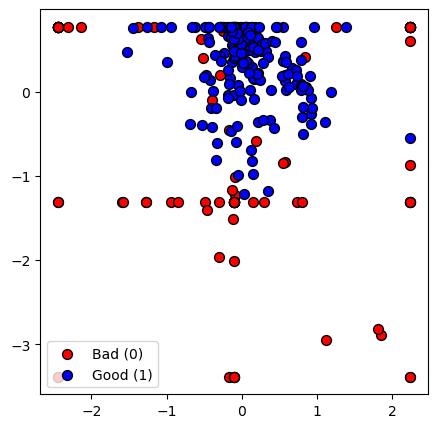

In [47]:
plt.figure(figsize = (5, 5))

plt.scatter(X_train[y_train == 0, 3], X_train[y_train == 0, 4], color = 'red', s = 50, label = 'Bad (0)', edgecolors = 'k')
plt.scatter(X_train[y_train == 1, 3], X_train[y_train == 1, 4], color = 'blue', s = 50, label = 'Good (1)', edgecolors = 'k')
plt.legend()
plt.show()

In [48]:
class Adaline:
    def __init__(self, lr = 0.01, n_epoch = 150):
        self.lr = lr
        self.n_epoch = n_epoch
        self.weight = None
        self.bias = None

    def __func__(self, X): # Linear function plus bias
        return np.dot(X, self.weight) + self.bias
        
    def fit(self, X, y):
        self.weight = np.zeros(X.shape[1])
        self.bias = 0. # Dot to show it's a real number

        for _ in range(self.n_epoch): # No activation
            output = self.__func__(X)
            error = output - y
            dw = 2 * np.dot(error, X) / X.shape[0]
            db = 2 * error.mean()

            self.weight = self.weight-self.lr * dw
            self.bias -= self.lr * db
            
    def predict(self, X):
        return np.where(self.__func__(X) >= 0.5, 1,0)

In [49]:
ada = Adaline(n_epoch = 300)
ada.fit(X_train, y_train)
confusion_matrix(y_test, ada.predict(X_test))

array([[23,  7],
       [ 0, 41]])

## **Logistic Regression:**

In [16]:
iono_df = pd.DataFrame(data = X_train, columns = X.columns.tolist())
iono_df = iono_df.iloc[:, :33]
iono_df['type'] = pd.DataFrame(data = y_train)

sns.pairplot(iono_df, hue = "type")
plt.show()

In [50]:
X2_train = X_train[:, [2, 21]] # 3rd and 22nd features
y2_train = y_train
X2_test = X_test[:, [2, 21]]
y2_test = y_test

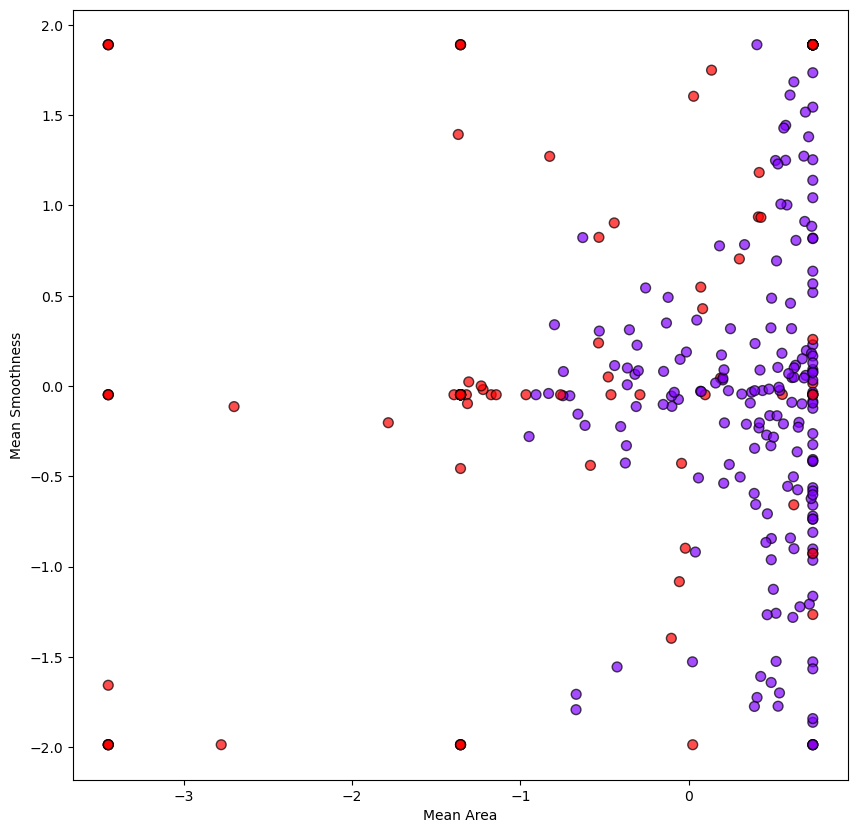

In [51]:
plt.figure(figsize = (10, 10))
plt.scatter(X2_train[:, 0], X2_train[:, 1], c = y2_train, cmap = 'rainbow_r', edgecolors = 'k', s = 50, alpha = 0.7)
plt.xlabel('Mean Area')
plt.ylabel('Mean Smoothness')
plt.show()

In [52]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

class LogRegSimple():
    def __init__(self, lr = 0.1, n_epoch = 100):
        self.lr = lr
        self.n_epoch = n_epoch
        self.weights = None
        self.bias = None

    def __forward__(self, X):
        return sigmoid(np.dot(X, self.weights) + self.bias)

    def fit(self, X, y):
        self.weights = np.array([0, 0])
        self.bias = 0


        for epoch in range(self.n_epoch):
            y_pred = self.__forward__(X)
            loss = (np.dot(-y, np.log(y_pred)) - np.dot(1 - y, np.log(1 - y_pred))) / X.shape[0]

            self.weights = self.weights + self.lr * np.dot(X.T, y - y_pred) / X.shape[0]
            self.bias += self.lr * (y - y_pred).mean()

        return self

    def predict(self, X):
        return self.__forward__(X).round()
    def param(self):
        return self.weights, self.bias

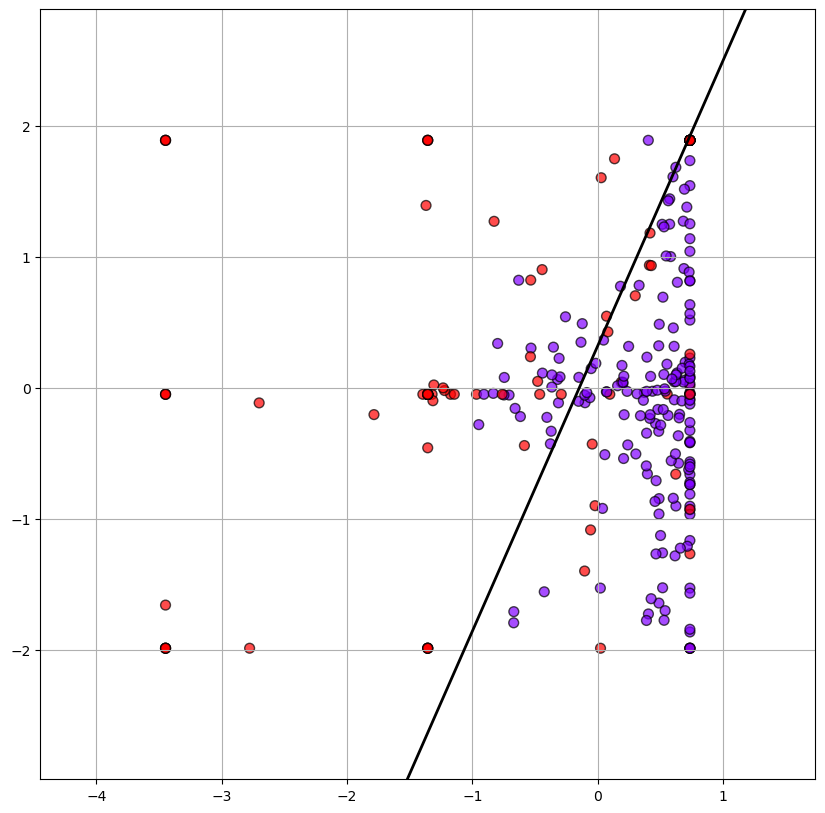

In [53]:
model = LogRegSimple(lr = 0.1, n_epoch = 200)
model.fit(X2_train, y2_train)


xv = np.arange(-2, 5, 0.1)
w,b = model.weights, model.bias
yv = (-xv * w[0] - b + 0.5) / w[1]

plt.figure(figsize = (10,10))
plt.scatter(X2_train[:, 0], X2_train[:, 1], c = y2_train, cmap = 'rainbow_r', edgecolors = 'k', s = 50, alpha = 0.7)
plt.plot(xv, yv, linewidth = 2, c = 'k')
plt.xlim([X2_train[:,0].min()-1, X2_train[:,0].max() + 1])
plt.ylim([X2_train[:,1].min()-1, X2_train[:,1].max() + 1])
plt.grid()
plt.show()

In [54]:
# Helper function to plot a decision boundary.
def plot_decision_boundary(X, y, model, resolution = 0.02):
    colors = ['red', 'blue', 'lightgreen', 'gray', 'cyan']
    cmap = ListedColormap(colors[:len(np.unique(y))])
    markers = ('s', 'x', 'o', '^', 'v')

    # Set min and max values and give it some padding
    x_min, x_max = X[:,0].min()-1, X[:,0].max() + 1
    y_min, y_max = X[:,1].min()-1, X[:,1].max() + 1

    # Generate a grid of points with distance h between them
    xx, yy = np.meshgrid(np.arange(x_min, x_max, resolution), np.arange(y_min, y_max, resolution))
    # Predict the function value for the whole grid
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    # Plot the contour and training examples
    plt.contourf(xx, yy, Z, alpha = 0.3, cmap = cmap)
    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())


    for idx, cl in enumerate(np.unique(y)):
        plt.scatter(X[y == cl, 0], X[y == cl, 1], color = cmap(idx), edgecolors = 'k', marker = markers[idx], label = cl)

C:\Users\sisik\AppData\Local\Temp\ipykernel_40168\3799812822.py:23: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(X[y == cl, 0], X[y == cl, 1], color = cmap(idx), edgecolors = 'k', marker = markers[idx], label = cl)


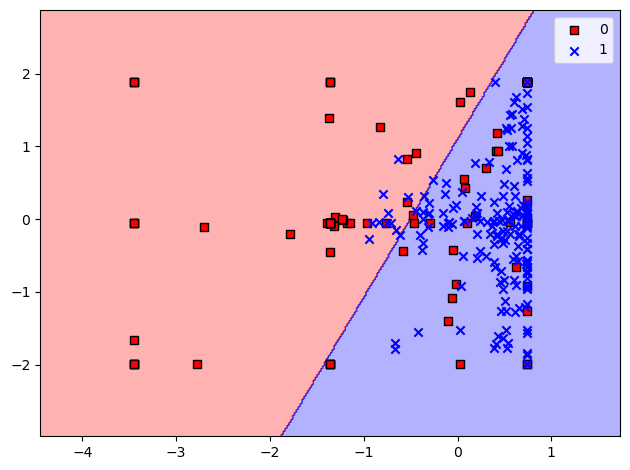

In [55]:
plot_decision_boundary(X2_train, y2_train, model) # Boundaries on training set
plt.legend()

plt.tight_layout()
plt.show()

In [56]:
y_train_pred = model.predict(X2_train)
confusion_matrix(y2_train, y_train_pred)

array([[ 47,  49],
       [ 11, 173]])

C:\Users\sisik\AppData\Local\Temp\ipykernel_40168\3799812822.py:23: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(X[y == cl, 0], X[y == cl, 1], color = cmap(idx), edgecolors = 'k', marker = markers[idx], label = cl)


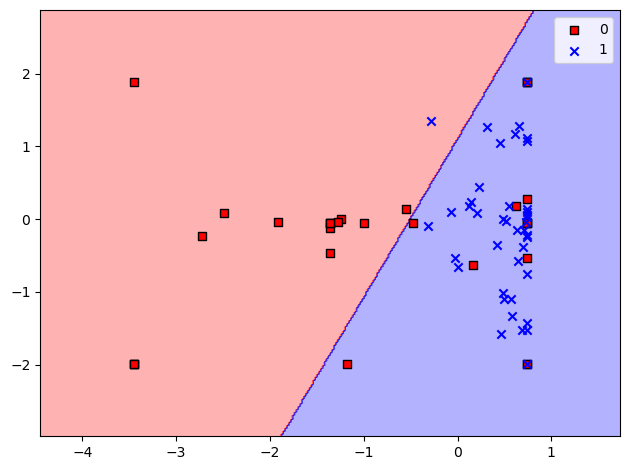

In [57]:
plot_decision_boundary(X2_test, y2_test, model) # Boundaries on test set
plt.legend()

plt.tight_layout()
plt.show()

In [59]:
y_test_pred = model.predict(X2_test)
confusion_matrix(y2_test, y_test_pred) # Less outliers than test

array([[16, 14],
       [ 1, 40]])